# Import Packages

In [ ]:
import os
import json
from re import T
from networks import Discriminator, Generator
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader
from torchvision import datasets, models, transforms
from torchvision.utils import save_image
from torchvision import utils as vutils
from torchvision.datasets import ImageFolder
from torch.autograd import Variable
from tqdm import tqdm
import torch.nn as nn
import torch.nn.functional as F
import torch
import numpy as np
from PIL import Image
from torch.utils.data import Dataset

# Peek at the architecture

In [ ]:
Generator()

Generator(
  (c7s1_64): Sequential(
    (0): ReflectionPad2d((3, 3, 3, 3))
    (1): Conv2d(3, 64, kernel_size=(7, 7), stride=(1, 1))
    (2): InstanceNorm2d(64, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
    (3): ReLU(inplace=True)
  )
  (c7s1_3): Sequential(
    (0): ReflectionPad2d((3, 3, 3, 3))
    (1): Conv2d(64, 3, kernel_size=(7, 7), stride=(1, 1), bias=False)
  )
  (d128): Sequential(
    (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
    (2): ReLU(inplace=True)
  )
  (d256): Sequential(
    (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
    (2): ReLU(inplace=True)
  )
  (r256): ResidualBlock(
    (conv_block): Sequential(
      (0): ReflectionPad2d((1, 1, 1, 1))
      (1): Conv2d(256, 256, kernel_

In [ ]:
Discriminator()

Discriminator(
  (c64): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (c128): Sequential(
    (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (c256): Sequential(
    (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (c512): Sequential(
    (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1), bias=False)
    (1): InstanceNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (c1): Conv2d(512, 1, kernel_size=(

# Import Configurations

In [ ]:
file = 'config.json'
config_file = open(file)
config = json.load(config_file)
config_file.close()
print(config)

{'n_epochs': 100, 'batch_size': 8, 'lr': 0.0002, 'b1': 0.5, 'b2': 0.999, 'n_cpu': 4, 'latent_dim': 100, 'img_size': 256, 'channels': 3, 'sample_interval': 100}


# Load Dataset

In [ ]:
class myDataset(Dataset):
    def __init__(self, data_dir, transform):
        '''
        change .png to .jpg if use real pizza images
        '''
        self.data_dir = data_dir
        self.transform = transform
        self.img_names = [
            name
            for name in list(
                filter(lambda x: x.endswith(".jpg"), os.listdir(self.data_dir)) 
            )
        ]

    def __getitem__(self, index):
        path_img = os.path.join(self.data_dir, self.img_names[index])
        img = Image.open(path_img).convert("RGB") #convert images to RGB format

        if self.transform is not None:
            img = self.transform(img)

        return img

    def __len__(self):
        if len(self.img_names) == 0:
            raise Exception(
                "\ndata_dir:{} is a empty dir! Please checkout your path to images!".format(
                    self.data_dir 
                )
            )
        return len(self.img_names)

# Resize Images, Convert to Tensor and Normalize

In [ ]:
dataset = "pizza/realpizza/"
ng_directory = os.path.join(dataset, "trainB")
ok_directory = os.path.join(dataset, "valB")

image_transforms = {
    "ng": transforms.Compose(
        [
            transforms.Resize([config['img_size'], config['img_size']]),
            transforms.ToTensor(),
            transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
        ]
    ),
    "ok": transforms.Compose(
        [
            transforms.Resize([config['img_size'], config['img_size']]),
            transforms.ToTensor(),
            transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
        ]
    ),
}

'''
Load the transformed images
'''
data = {
    "ng": myDataset(data_dir=ng_directory, transform=image_transforms["ng"]),
    "ok": myDataset(data_dir=ok_directory, transform=image_transforms["ok"]),
}

dataloader = DataLoader(data["ng"], batch_size=config['batch_size'], shuffle=True)
ng_data_size = len(data["ng"])
ok_data_size = len(data["ok"])
print("train_size: {:4d}  valid_size:{:4d}".format(ng_data_size, ok_data_size))

train_size: 6688  valid_size: 824


# Training

In [ ]:
'''
Initialize number of GPUs and set device to CUDA
'''
ngpu = 4 
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 1) else "cpu")
print(f'Using {device} device')

Using cuda:0 device


## Initialize Weights

In [ ]:
def weights_init_normal(m):
    classname = m.__class__.__name__
    if classname.find("Conv") != -1:
        torch.nn.init.normal_(m.weight.data, 0.0, 0.02)

## Loss function

In [ ]:
adversarial_loss = torch.nn.BCEWithLogitsLoss()
def adversarial_loss2(i ,j):
    # return F.binary_cross_entropy(i,j)
    return F.mse_loss(i, j)
adversarial_loss.to(device)

BCEWithLogitsLoss()

## Initialize generator and discriminator

In [ ]:
generator = Generator()
discriminator = Discriminator()
generator.apply(weights_init_normal)
discriminator.apply(weights_init_normal)

generator.to(device)
discriminator.to(device)

Discriminator(
  (c64): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (c128): Sequential(
    (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (c256): Sequential(
    (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (c512): Sequential(
    (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1), bias=False)
    (1): InstanceNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (c1): Conv2d(512, 1, kernel_size=(

In [ ]:
if (device.type == "cuda") and (config['n_cpu']>1):
    generator = nn.DataParallel(generator, list(range(4)))
if (device.type == "cuda") and (config['n_cpu']>1):
    discriminator = nn.DataParallel(discriminator, list(range(4)))

## Optimizers

In [ ]:
'''
Create Adam Optimizers for Generator and Discriminator
'''
optimizer_G = torch.optim.Adam(
    generator.parameters(), lr=config['lr'], betas=(config['b1'], config['b2'])
)
optimizer_D = torch.optim.Adam(
    discriminator.parameters(), lr=config['lr'], betas=(config['b1'], config['b2'])
)
Tensor = torch.cuda.FloatTensor

In [ ]:
torch.cuda.empty_cache()
import gc
gc.collect()

# Train the Model

In [ ]:
fh = open(r"log", 'w')
score = nn.Sigmoid()

for epoch in range(50):
    for i, imgs in enumerate(dataloader):
        # Sample noise as generator input
        z = torch.randn(config['batch_size'], 3, 256, 256, device=device)
        # Configure input
        real_imgs = Variable(imgs.type(Tensor)).to(device)
       
        # ---------------------
        #  Train Discriminator
        # ---------------------
        optimizer_D.zero_grad()
        bb = discriminator(real_imgs)
        real = torch.ones_like(bb,device=device)
        fake = torch.zeros_like(bb,device=device)
        one  = torch.ones_like(bb,device=device)
        real_loss = adversarial_loss(bb, real)
      
        fake_loss = adversarial_loss(discriminator(generator(z).detach()), fake)
        d_loss = (real_loss + fake_loss) / 2
       
        d_loss.backward()
        with torch.no_grad():
                Dx = score(bb).mean().item()
        optimizer_D.step()
        # -----------------
        #  Train Generator
        # -----------------

        optimizer_G.zero_grad()
        
        # Generate a batch of images
        gen_imgs = generator(z)
        
        aa = discriminator(gen_imgs)
        
        # print(aa.shape, valid.shape)
        g_loss = adversarial_loss(aa, one)
        # g_loss = F.binary_cross_entropy(aa, fake)
        g_loss.backward()
        with torch.no_grad():
                Dgz = score(aa).mean().item()
        optimizer_G.step()

        result =  "Epoch %d/%d, Batch %d/%d, D: %f, G: %f, Dx:%f, D(g(z)): %f\n" % (epoch, config['n_epochs'], i, len(dataloader), d_loss.item(), g_loss.item(),Dx, Dgz)
        fh.write(result)
        print(result)
        batches_done = epoch * len(dataloader) + i
        os.makedirs("images",exist_ok=True)
        if batches_done % config['sample_interval'] == 0:
            save_image(
                gen_imgs.data[:4],
                 f"./images/epoch{epoch}_batch{i}.png",
                nrow=2,
                normalize=True,
            )
    # if epoch % 5 == 0:
    os.makedirs("model",exist_ok=True)
    torch.save(generator.state_dict(), f"./model/generator_epoch{epoch}.pth")
    torch.save(discriminator.state_dict(), f"./model/discriminator_epoch{epoch}.pth")

fh.close()

Epoch 0/100, Batch 0/836, D: 0.642865, G: 1.042721, Dx:0.584868, D(g(z)): 0.386142

Epoch 0/100, Batch 1/836, D: 0.630190, G: 1.024374, Dx:0.572712, D(g(z)): 0.372236

Epoch 0/100, Batch 2/836, D: 0.693136, G: 1.056491, Dx:0.526099, D(g(z)): 0.367043

Epoch 0/100, Batch 3/836, D: 0.712788, G: 1.152258, Dx:0.521336, D(g(z)): 0.336199

Epoch 0/100, Batch 4/836, D: 0.618753, G: 1.096733, Dx:0.550412, D(g(z)): 0.348133

Epoch 0/100, Batch 5/836, D: 0.626122, G: 0.934950, Dx:0.525621, D(g(z)): 0.403886

Epoch 0/100, Batch 6/836, D: 0.632253, G: 0.887775, Dx:0.559982, D(g(z)): 0.422340

Epoch 0/100, Batch 7/836, D: 0.659721, G: 0.946501, Dx:0.578257, D(g(z)): 0.400110

Epoch 0/100, Batch 8/836, D: 0.637547, G: 1.133888, Dx:0.517411, D(g(z)): 0.335164

Epoch 0/100, Batch 9/836, D: 0.646082, G: 1.097155, Dx:0.492014, D(g(z)): 0.349358

Epoch 0/100, Batch 10/836, D: 0.584509, G: 1.133781, Dx:0.561556, D(g(z)): 0.335187

Epoch 0/100, Batch 11/836, D: 0.571883, G: 1.107548, Dx:0.552284, D(g(z)): 

## Visualize Results

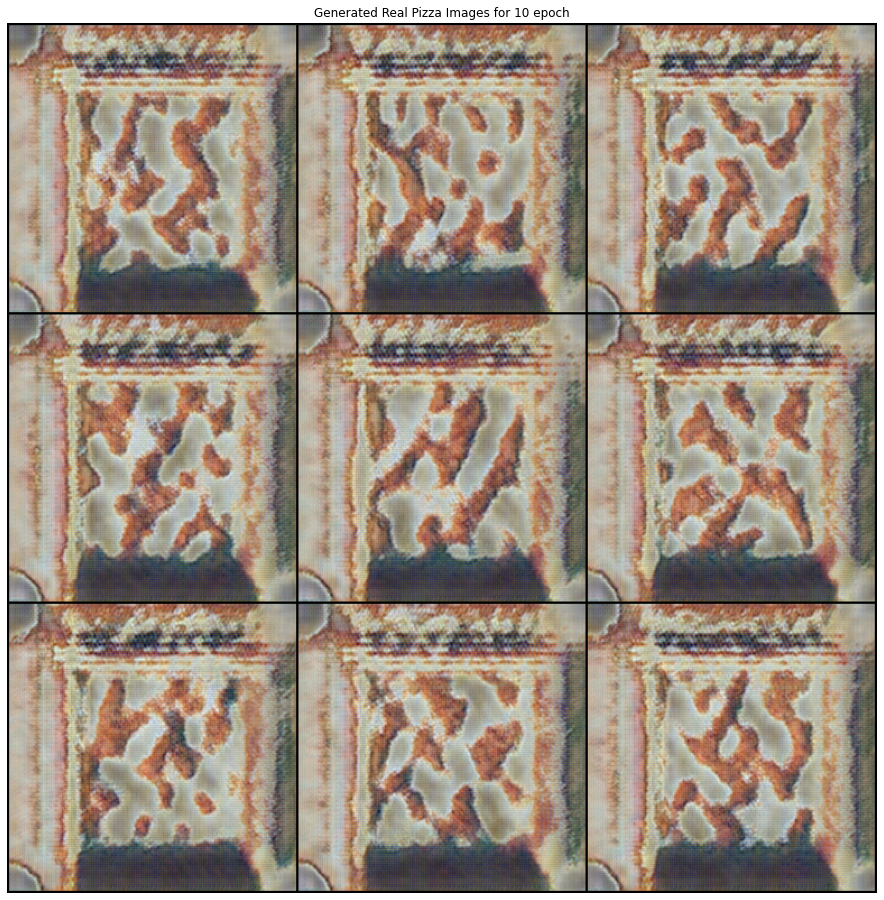

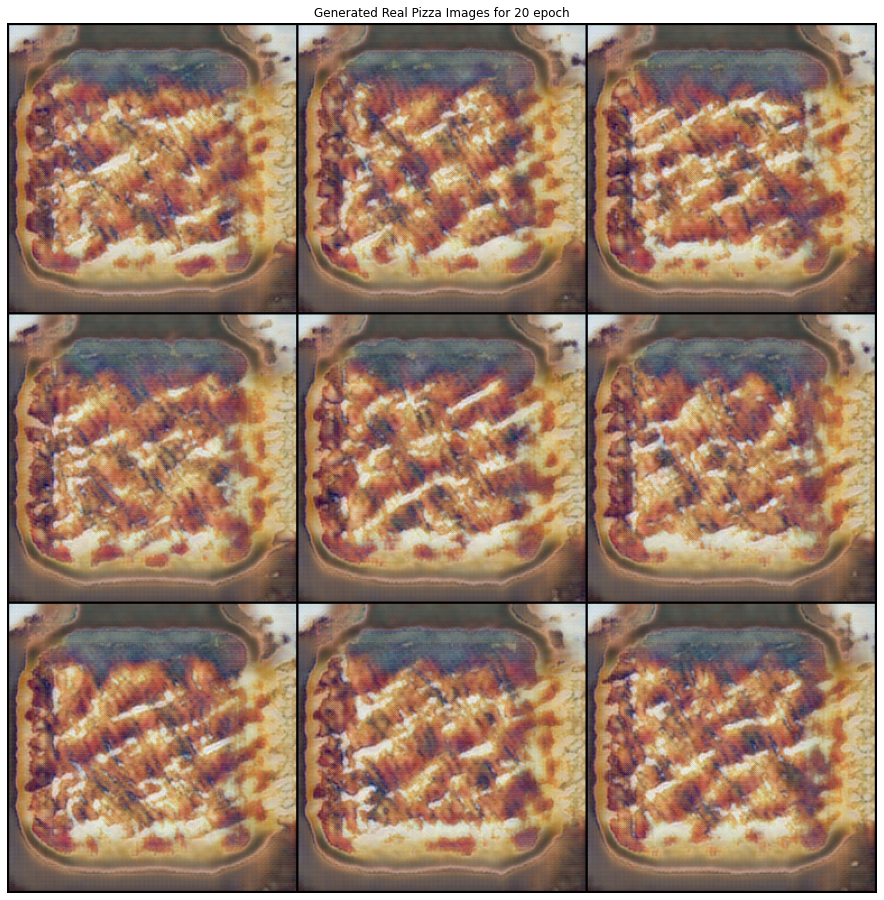

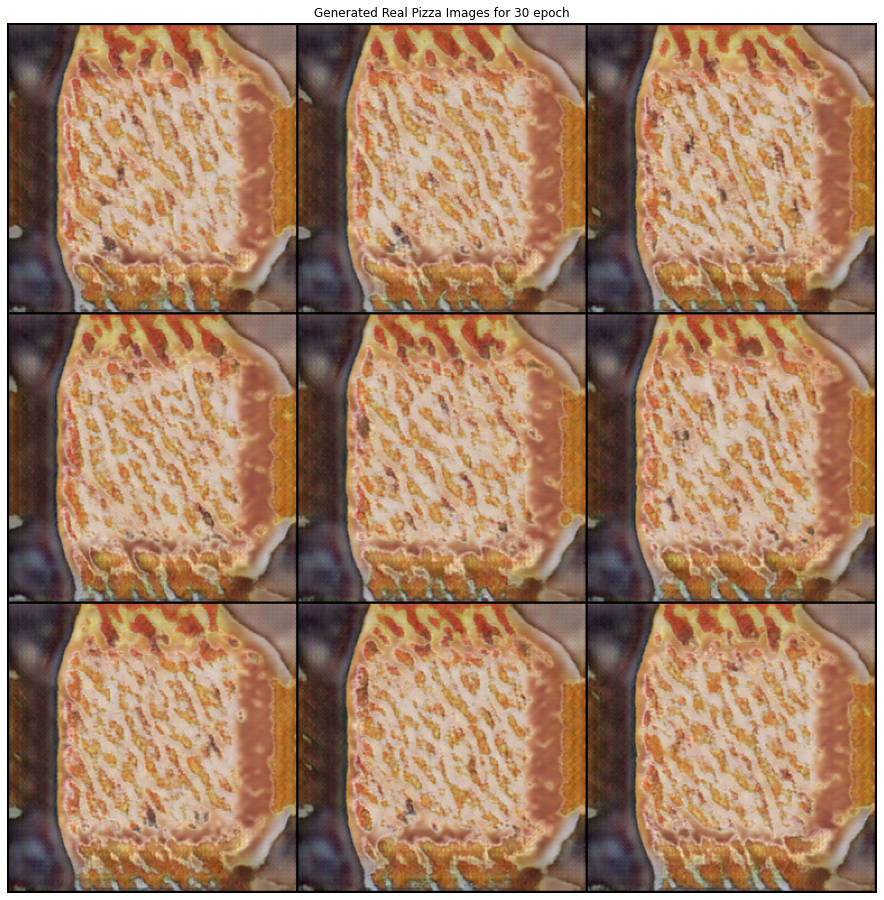

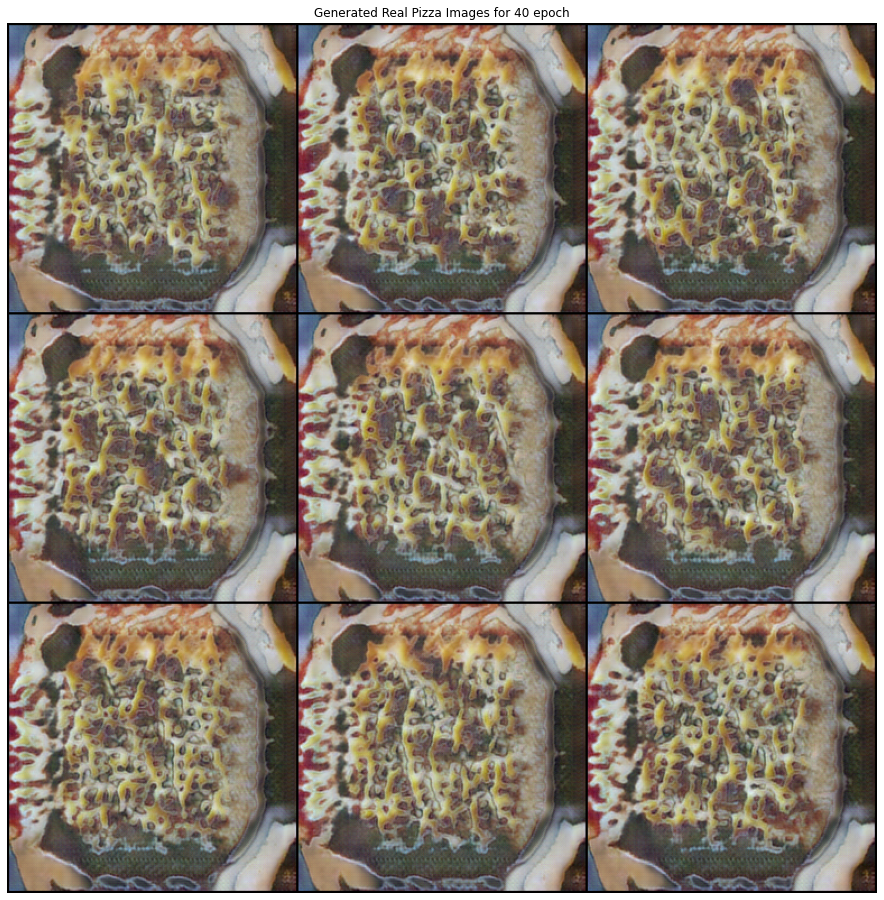

In [ ]:
from networks import Generator
import matplotlib.pyplot as plt
import torch,os
from torchvision.utils import save_image
for i in range(1, 50):
    model = Generator()
    model.load_state_dict(torch.load(f"./model/generator_epoch{i}.pth"))
    z = torch.randn(9, 3, 256, 256, device="cpu")
    gen_imgs = model(z)
    #Save the results
    os.makedirs("results",exist_ok=True)
    save_image(
                    gen_imgs.data[:9],
                    f"./results/epoch{i+1}.jpg",
                    nrow=3,
                    normalize=True,
                )
    if i%10 == 0:
        im_grid = vutils.make_grid(gen_imgs.data[:9], padding = 2, normalize=True, nrow = 3).cpu()
        plt.figure(figsize=(16,16))
        plt.axis("off")
        plt.title("Generated Real Pizza Images for {:} epoch".format(i))
        plt.imshow(np.transpose(im_grid))

# Synthetic Pizza


Note: Due to the size of the data, we trained using python scripts pushed to ilabs. We are loading the models persisted here to generate a few fake images.

## Visualize Results

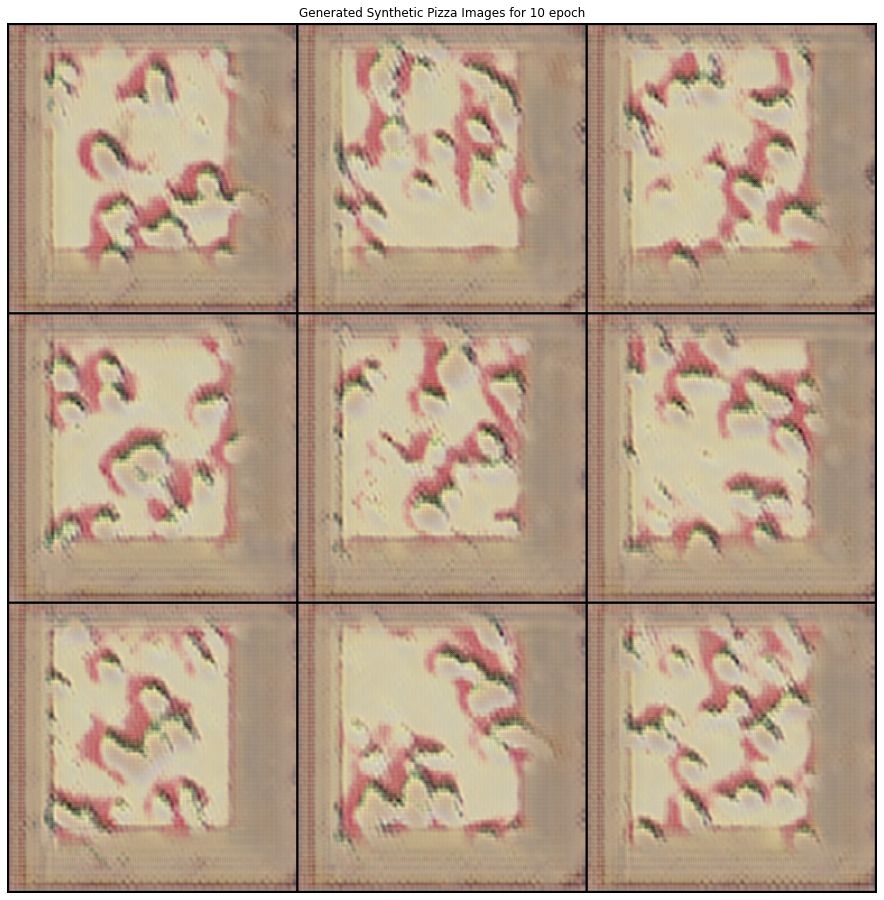

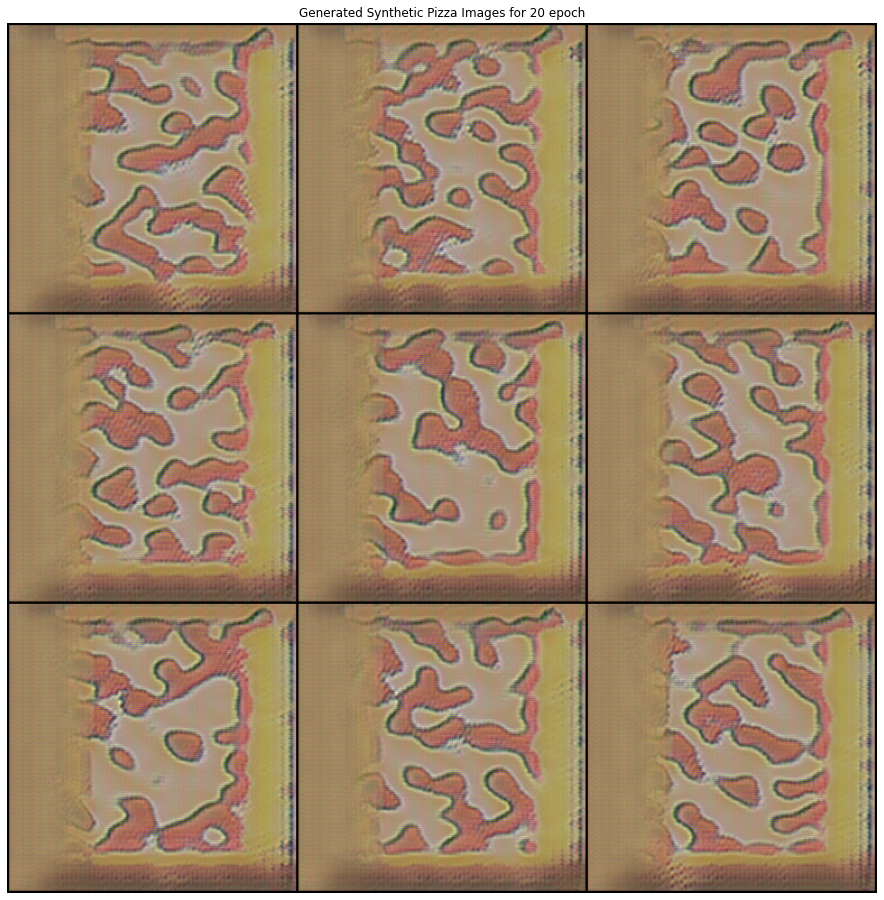

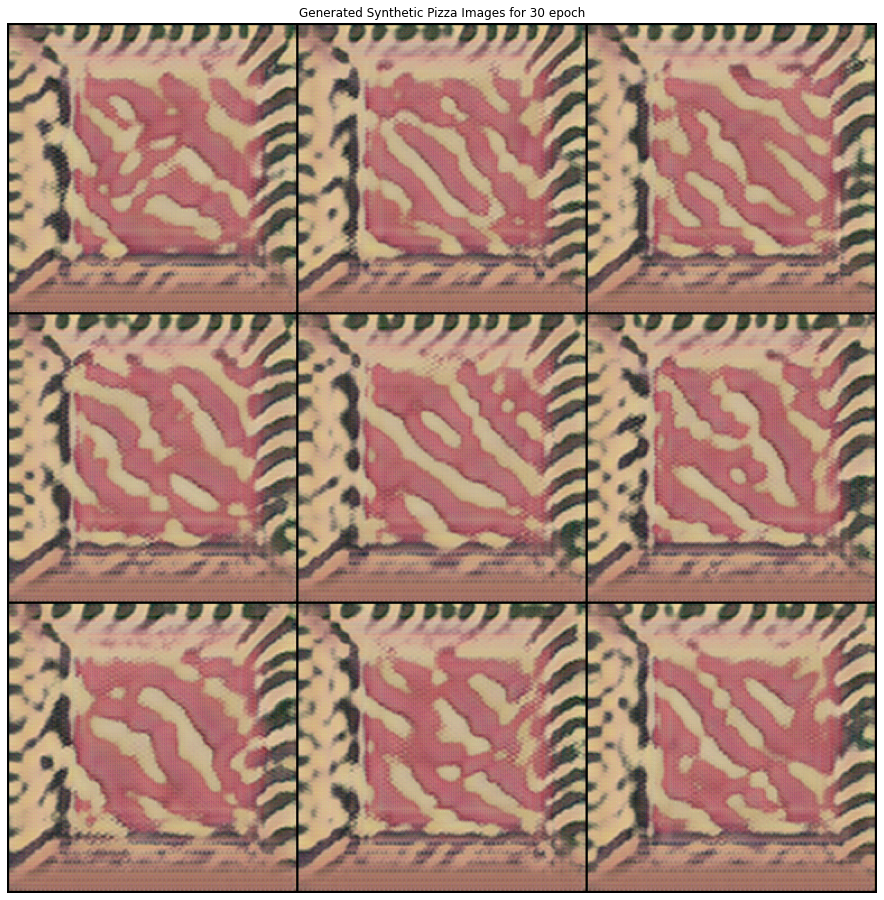

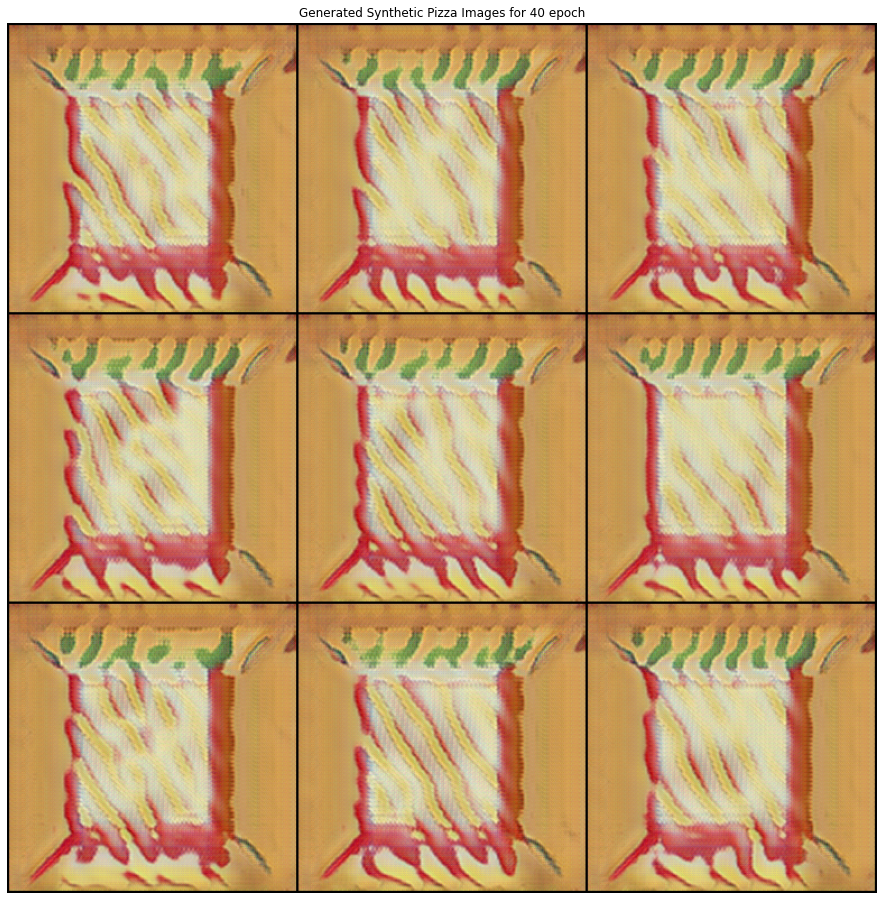

In [ ]:
from networks import Generator
import matplotlib.pyplot as plt
import torch,os
from torchvision.utils import save_image
for i in range(1, 50):
    model = Generator()
    model.load_state_dict(torch.load(f"./model/generator_epoch{i}.pth"))
    z = torch.randn(9, 3, 256, 256, device="cpu")
    gen_imgs = model(z)
    #Save the results
    os.makedirs("results",exist_ok=True)
    save_image(
                    gen_imgs.data[:9],
                    f"./synthetic_results/epoch{i+1}.jpg",
                    nrow=3,
                    normalize=True,
                )
    if i%10 == 0:
        im_grid = vutils.make_grid(gen_imgs.data[:9], padding = 2, normalize=True, nrow = 3).cpu()
        plt.figure(figsize=(16,16))
        plt.axis("off")
        plt.title("Generated Synthetic Pizza Images for {:} epoch".format(i))
        plt.imshow(np.transpose(im_grid))